***Начнем нашу работу над проектом.*** 

1. Первым делом загрузим данные используя код которую предоставили в методичке
    * Функции включают в себя считывания набора данных parquet и подготовку данных


2. Далее загрузим датафрейм с целевой переменной


3. Объеденим датафреймы по колонке id


4. Проверим объедененный датафрейм на пропуски и выбросы а так же посмотрим на распределение данных


5. Постараемся понять с помощью графиков и корреляции есть ли зависимые переменные


6. Обробатываем датафрейм, удаляем не нужное и добавляем нужные


7. Создаем модели машинного обучения разных(но сильных) видов.


8. Ищем оптимальные гиперпараметры(одну и ту же строчку кода с разными гиперпараметрами я возможно запускал более 100 раз)


9. Находим наилучшую модель для данной задачи и сохраняем предикты

# 0. Импортируем библеотеки

In [1]:
# импортируем библеотеки

import os
import pandas as pd
import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, confusion_matrix
from sklearn.utils import class_weight
# from imblearn.over_sampling import SMOTE
from sklearn.model_selection import KFold
from sklearn.preprocessing import OneHotEncoder

from skopt import BayesSearchCV
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from skorch import NeuralNetClassifier
from sklearn.model_selection import StratifiedKFold

import warnings
warnings.filterwarnings('ignore')

# 1. Загрузим данные

In [2]:
# путь до данных на компьютере
path = 'traindata/'

In [3]:
# функция для считывания набора данных parquet

def read_parquet_dataset_from_local(path_to_dataset: str, start_from: int = 0,
                                     num_parts_to_read: int = 2, columns=None, verbose=False) -> pd.DataFrame:
    """
    читает num_parts_to_read партиций, преобразовывает их к pd.DataFrame и возвращает
    :param path_to_dataset: путь до директории с партициями
    :param start_from: номер партиции, с которой нужно начать чтение
    :param num_parts_to_read: количество партиций, которые требуется прочитать
    :param columns: список колонок, которые нужно прочитать из партиции
    :return: pd.DataFrame
    """

    res = []
    dataset_paths = sorted([os.path.join(path_to_dataset, filename) for filename in os.listdir(path_to_dataset)
                              if filename.startswith('train')])
    print(dataset_paths)

    start_from = max(0, start_from)
    chunks = dataset_paths[start_from: start_from + num_parts_to_read]
    if verbose:
        print('Reading chunks:\n')
        for chunk in chunks:
            print(chunk)
    for chunk_path in tqdm.tqdm_notebook(chunks, desc="Reading dataset with pandas"):
        print('chunk_path', chunk_path)
        chunk = pd.read_parquet(chunk_path,columns=columns)
        res.append(chunk)

    return pd.concat(res).reset_index(drop=True)

In [4]:
# функция для подготовки данных

def prepare_transactions_dataset(path_to_dataset: str, num_parts_to_preprocess_at_once: int = 1, num_parts_total: int=50,
                                 save_to_path=None, verbose: bool=False):
    """
    возвращает готовый pd.DataFrame с признаками, на которых можно учить модель для целевой задачи
    path_to_dataset: str
        путь до датасета с партициями
    num_parts_to_preprocess_at_once: int
        количество партиций, которые будут одновременно держаться и обрабатываться в памяти
    num_parts_total: int
        общее количество партиций, которые нужно обработать
    save_to_path: str
        путь до папки, в которой будет сохранён каждый обработанный блок в .parquet-формате; если None, то не будет сохранён
    verbose: bool
        логирует каждую обрабатываемую часть данных
    """
    preprocessed_frames = []

    for step in tqdm.tqdm_notebook(range(0, num_parts_total, num_parts_to_preprocess_at_once),
                                   desc="Transforming transactions data"):
        transactions_frame = read_parquet_dataset_from_local(path_to_dataset, step, num_parts_to_preprocess_at_once,
                                                             verbose=verbose)


   #здесь должен быть препроцессинг данных


   #записываем подготовленные данные в файл
        if save_to_path:
            block_as_str = str(step)
            if len(block_as_str) == 1:
                block_as_str = '00' + block_as_str
            else:
                block_as_str = '0' + block_as_str
            transactions_frame.to_parquet(os.path.join(save_to_path, f'processed_chunk_{block_as_str}.parquet'))

        preprocessed_frames.append(transactions_frame)
    return pd.concat(preprocessed_frames)

In [5]:
data = prepare_transactions_dataset(path, num_parts_to_preprocess_at_once=2, num_parts_total=2,
                                    save_to_path='traindata/')

Transforming transactions data:   0%|          | 0/1 [00:00<?, ?it/s]

['traindata/train_data_0.pq', 'traindata/train_data_1.pq', 'traindata/train_data_10.pq', 'traindata/train_data_11.pq', 'traindata/train_data_2.pq', 'traindata/train_data_3.pq', 'traindata/train_data_4.pq', 'traindata/train_data_5.pq', 'traindata/train_data_6.pq', 'traindata/train_data_7.pq', 'traindata/train_data_8.pq', 'traindata/train_data_9.pq']


Reading dataset with pandas:   0%|          | 0/2 [00:00<?, ?it/s]

chunk_path traindata/train_data_0.pq
chunk_path traindata/train_data_1.pq


In [6]:
# посмотрим на первые 5 строк

data.head()

,id,rn,pre_since_opened,pre_since_confirmed,pre_pterm,pre_fterm,pre_till_pclose,pre_till_fclose,pre_loans_credit_limit,pre_loans_next_pay_summ,...,enc_paym_21,enc_paym_22,enc_paym_23,enc_paym_24,enc_loans_account_holder_type,enc_loans_credit_status,enc_loans_credit_type,enc_loans_account_cur,pclose_flag,fclose_flag
0,0,1,18,9,2,3,16,10,11,3,...,3,3,3,4,1,3,4,1,0,0
1,0,2,18,9,14,14,12,12,0,3,...,0,0,0,4,1,3,4,1,0,0
2,0,3,18,9,4,8,1,11,11,0,...,0,0,0,4,1,2,3,1,1,1
3,0,4,4,1,9,12,16,7,12,2,...,3,3,3,4,1,3,1,1,0,0
4,0,5,5,12,15,2,11,12,10,2,...,3,3,3,4,1,3,4,1,0,0


In [7]:
# посмотрим на размерности данных

data.shape

(4082029, 61)

# 2. Загрузим датафрейм с целевой переменной

In [8]:
# значения целевой переменной (смерджить с фичами по id)

targets = pd.read_csv('train_target.csv')
targets.head()

,id,flag
0,0,0
1,1,0
2,2,0
3,3,0
4,4,0


In [9]:
targets.shape

# видим что целевой переменной меньше. Будем объеденять по нему

(3000000, 2)

# 3. Объеденяем датафреймы по колонке id

In [10]:
# Создаем merged_df из слияния датафрейма и таргет датафрейма

merged_df = pd.merge(data, targets, on='id', how='inner')

In [11]:
merged_df.shape

(4082029, 62)

# 4. Проверим объедененный датафрейм на пропуски и выбросы а так же посмотрим на распределение данных

In [12]:
# По итогу слияния видим что строк больше чем ожидалось. Возможно изза дубликатов. Проверим

print(data.duplicated('id').sum())
print(targets.duplicated('id').sum())

3582029
0


Видим очень много дубликатов в айди. Мы знаем что id это номер заявки. А заявка не должна дублироваться. Значит сначала удалим дубликаты и только потом приступим к объеденению даатфреймов

In [13]:
# # Удаление дубликатов из DataFrame
# data.drop_duplicates(subset='id', keep='first', inplace=True)

# # Переиндексация DataFrame после удаления дубликатов
# data.reset_index(drop=True, inplace=True)

In [14]:
# data.shape

(500000, 61)

Вижу странную картинку. Пока оставим все как есть. Спрошу потом у куратора. Оставлю тут коментарии на случай если забуду

In [15]:
# Посмотрим на колонки

merged_df.columns

Index(['id', 'rn', 'pre_since_opened', 'pre_since_confirmed', 'pre_pterm',
       'pre_fterm', 'pre_till_pclose', 'pre_till_fclose',
       'pre_loans_credit_limit', 'pre_loans_next_pay_summ',
       'pre_loans_outstanding', 'pre_loans_total_overdue',
       'pre_loans_max_overdue_sum', 'pre_loans_credit_cost_rate', 'pre_loans5',
       'pre_loans530', 'pre_loans3060', 'pre_loans6090', 'pre_loans90',
       'is_zero_loans5', 'is_zero_loans530', 'is_zero_loans3060',
       'is_zero_loans6090', 'is_zero_loans90', 'pre_util', 'pre_over2limit',
       'pre_maxover2limit', 'is_zero_util', 'is_zero_over2limit',
       'is_zero_maxover2limit', 'enc_paym_0', 'enc_paym_1', 'enc_paym_2',
       'enc_paym_3', 'enc_paym_4', 'enc_paym_5', 'enc_paym_6', 'enc_paym_7',
       'enc_paym_8', 'enc_paym_9', 'enc_paym_10', 'enc_paym_11', 'enc_paym_12',
       'enc_paym_13', 'enc_paym_14', 'enc_paym_15', 'enc_paym_16',
       'enc_paym_17', 'enc_paym_18', 'enc_paym_19', 'enc_paym_20',
       'enc_paym_21', 

In [21]:
# Посмотрим есть ли пропуски

merged_df.isna().sum()[merged_df.isna().sum() > 1]

Series([], dtype: int64)

Пропусков нет. Это очень хорошо

In [23]:
# Посмотрим на распределение данных

merged_df.describe()

,id,rn,pre_since_opened,pre_since_confirmed,pre_pterm,pre_fterm,pre_till_pclose,pre_till_fclose,pre_loans_credit_limit,pre_loans_next_pay_summ,...,enc_paym_22,enc_paym_23,enc_paym_24,enc_loans_account_holder_type,enc_loans_credit_status,enc_loans_credit_type,enc_loans_account_cur,pclose_flag,fclose_flag,flag
count,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,...,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06,4.082029e+06
mean,2.551872e+05,6.684866e+00,9.270089e+00,8.389524e+00,8.302433e+00,8.297983e+00,7.035295e+00,8.361266e+00,9.732238e+00,2.398732e+00,...,2.343521e+00,2.377364e+00,3.566155e+00,1.027801e+00,2.693075e+00,3.342639e+00,1.002258e+00,1.666948e-01,2.302343e-01,2.938024e-02
std,1.444161e+05,5.204283e+00,5.746401e+00,4.689799e+00,5.267078e+00,4.446791e+00,5.182510e+00,4.225813e+00,5.801353e+00,1.372324e+00,...,1.227935e+00,1.204887e+00,1.045987e+00,2.767134e-01,4.887125e-01,1.068137e+00,5.678184e-02,3.727032e-01,4.209828e-01,1.688699e-01
min,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.306590e+05,3.000000e+00,4.000000e+00,5.000000e+00,4.000000e+00,6.000000e+00,2.000000e+00,5.000000e+00,5.000000e+00,2.000000e+00,...,3.000000e+00,3.000000e+00,4.000000e+00,1.000000e+00,2.000000e+00,3.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.581200e+05,5.000000e+00,9.000000e+00,9.000000e+00,8.000000e+00,8.000000e+00,7.000000e+00,1.000000e+01,1.000000e+01,2.000000e+00,...,3.000000e+00,3.000000e+00,4.000000e+00,1.000000e+00,3.000000e+00,4.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
75%,3.809860e+05,9.000000e+00,1.400000e+01,1.200000e+01,1.300000e+01,1.100000e+01,1.200000e+01,1.100000e+01,1.500000e+01,2.000000e+00,...,3.000000e+00,3.000000e+00,4.000000e+00,1.000000e+00,3.000000e+00,4.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
max,4.999990e+05,5.100000e+01,1.900000e+01,1.700000e+01,1.700000e+01,1.600000e+01,1.600000e+01,1.500000e+01,1.900000e+01,6.000000e+00,...,3.000000e+00,3.000000e+00,4.000000e+00,6.000000e+00,6.000000e+00,5.000000e+00,3.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00


Видим что это ну очень не удобно да и большая часть даже не видна. Попробуем вывести описательные статистики по 10 колонок

In [24]:
# Определение количества колонок
num_columns = len(merged_df.columns)

# Цикл для вывода описательной статистики по десяти колонкам
for i in range(0, num_columns, 10):
    subset_columns = merged_df.columns[i:i+10]
    subset_df = merged_df[subset_columns]
    print(subset_df.describe())

                 id            rn  pre_since_opened  pre_since_confirmed  \
count  4.082029e+06  4.082029e+06      4.082029e+06         4.082029e+06   
mean   2.551872e+05  6.684866e+00      9.270089e+00         8.389524e+00   
std    1.444161e+05  5.204283e+00      5.746401e+00         4.689799e+00   
min    0.000000e+00  1.000000e+00      0.000000e+00         0.000000e+00   
25%    1.306590e+05  3.000000e+00      4.000000e+00         5.000000e+00   
50%    2.581200e+05  5.000000e+00      9.000000e+00         9.000000e+00   
75%    3.809860e+05  9.000000e+00      1.400000e+01         1.200000e+01   
max    4.999990e+05  5.100000e+01      1.900000e+01         1.700000e+01   

          pre_pterm     pre_fterm  pre_till_pclose  pre_till_fclose  \
count  4.082029e+06  4.082029e+06     4.082029e+06     4.082029e+06   
mean   8.302433e+00  8.297983e+00     7.035295e+00     8.361266e+00   
std    5.267078e+00  4.446791e+00     5.182510e+00     4.225813e+00   
min    0.000000e+00  0.000000e+

        enc_paym_20   enc_paym_21   enc_paym_22   enc_paym_23   enc_paym_24  \
count  4.082029e+06  4.082029e+06  4.082029e+06  4.082029e+06  4.082029e+06   
mean   3.283820e+00  2.313370e+00  2.343521e+00  2.377364e+00  3.566155e+00   
std    1.265549e+00  1.247471e+00  1.227935e+00  1.204887e+00  1.045987e+00   
min    1.000000e+00  0.000000e+00  0.000000e+00  0.000000e+00  1.000000e+00   
25%    4.000000e+00  3.000000e+00  3.000000e+00  3.000000e+00  4.000000e+00   
50%    4.000000e+00  3.000000e+00  3.000000e+00  3.000000e+00  4.000000e+00   
75%    4.000000e+00  3.000000e+00  3.000000e+00  3.000000e+00  4.000000e+00   
max    4.000000e+00  3.000000e+00  3.000000e+00  3.000000e+00  4.000000e+00   

       enc_loans_account_holder_type  enc_loans_credit_status  \
count                   4.082029e+06             4.082029e+06   
mean                    1.027801e+00             2.693075e+00   
std                     2.767134e-01             4.887125e-01   
min                     0.00

Так гораздо удобнее. И мы не видим выбросов что очень хорошо

In [25]:
# Посмотрим на распределение целевой переменной

merged_df['flag'].value_counts()

flag
0    3962098
1     119931
Name: count, dtype: int64

Очень не сбалансировано. При обучении модели нужно будет поставить class_weight='balanced', а если значения метрик будет низкой то нужно будет использовать SMOTE для более лучшего распределения значении целевой переменной

In [27]:
# Проверим на наличие дубликатов

merged_df.duplicated().sum()

0

# 5. Выведем корреляцю и построим графики зависимости от целевой переменной

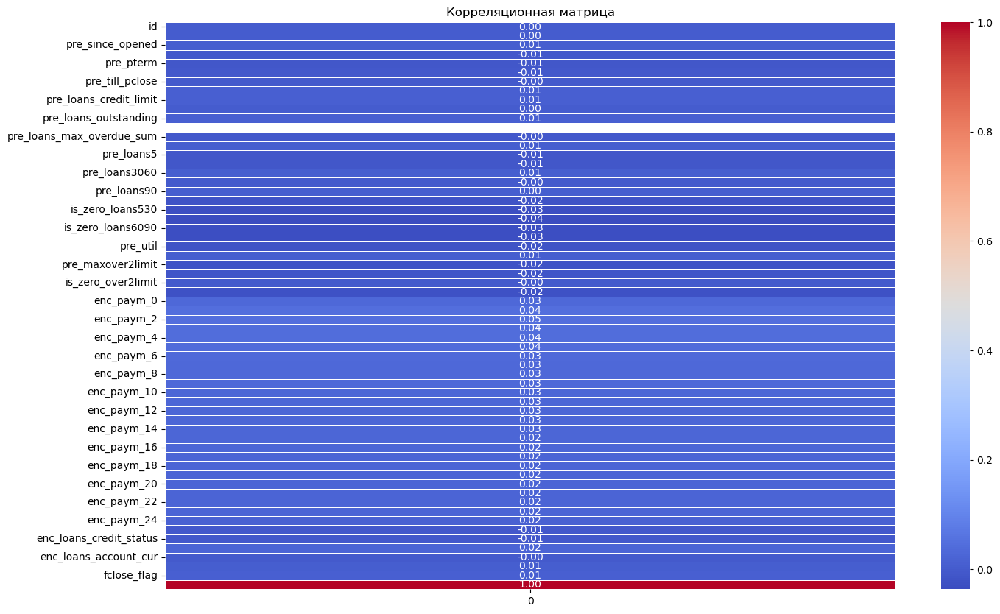

In [12]:
# Посмотрим на корреляцию можду признаками в виде графика

# Вычисление матрицы корреляции с целевой переменной "flag"
correlation_matrix = merged_df.corrwith(merged_df['flag'])

# Построение тепловой карты корреляционной матрицы
plt.figure(figsize=(16, 10))
sns.heatmap(correlation_matrix.to_frame(), annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Корреляционная матрица')
plt.show()

In [34]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4082029 entries, 0 to 4082028
Data columns (total 62 columns):
 #   Column                         Dtype
---  ------                         -----
 0   id                             int64
 1   rn                             int64
 2   pre_since_opened               int64
 3   pre_since_confirmed            int64
 4   pre_pterm                      int64
 5   pre_fterm                      int64
 6   pre_till_pclose                int64
 7   pre_till_fclose                int64
 8   pre_loans_credit_limit         int64
 9   pre_loans_next_pay_summ        int64
 10  pre_loans_outstanding          int64
 11  pre_loans_total_overdue        int64
 12  pre_loans_max_overdue_sum      int64
 13  pre_loans_credit_cost_rate     int64
 14  pre_loans5                     int64
 15  pre_loans530                   int64
 16  pre_loans3060                  int64
 17  pre_loans6090                  int64
 18  pre_loans90                    int64
 19  

Так как мы не видим всех колонок в коррелияционной матрице придется пойти на хитрость и вывести только 30 наибоее больших корреляции с целевым признаком

In [43]:
# Вычисление матрицы корреляции с целевой переменной "flag"
correlation_with_flag = merged_df.corrwith(merged_df['flag'])

# Сортировка значений корреляции по убыванию
correlation_sorted = correlation_with_flag.sort_values(ascending=False)

# Вывод отсортированных значений корреляции
pd.set_option('display.max_rows', None)
print(correlation_sorted)

flag                             1.000000
enc_paym_2                       0.047319
enc_paym_1                       0.044764
enc_paym_3                       0.044466
enc_paym_4                       0.040436
enc_paym_5                       0.037370
enc_paym_6                       0.033621
enc_paym_7                       0.032146
enc_paym_8                       0.030709
enc_paym_0                       0.029912
enc_paym_9                       0.029316
enc_paym_10                      0.026937
enc_paym_11                      0.025837
enc_paym_13                      0.025592
enc_paym_12                      0.025471
enc_paym_14                      0.025417
enc_paym_15                      0.024947
enc_paym_16                      0.024295
enc_loans_credit_type            0.024142
enc_paym_17                      0.023937
enc_paym_18                      0.023842
enc_paym_19                      0.023279
enc_paym_20                      0.022627
enc_paym_21                      0

Очень странно ведь мы знаем что дефолт это просрочка более чем на 90 дней, а pre_loans90 это число просрочек более, чем на 90 дней. Построим скаттер плот для них

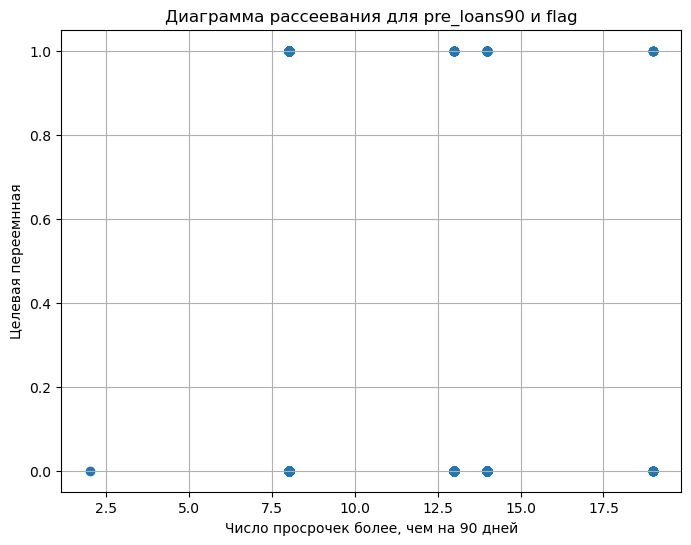

In [44]:
plt.figure(figsize=(8, 6))
plt.scatter(merged_df['pre_loans90'], merged_df['flag'])
plt.xlabel('Число просрочек более, чем на 90 дней')
plt.ylabel('Целевая переемнная')
plt.title('Диаграмма рассеевания для pre_loans90 и flag')
plt.grid(True)
plt.show()

In [45]:
merged_df['pre_loans90'].value_counts()

pre_loans90
8     4081226
14        665
13        118
19         19
2           1
Name: count, dtype: int64

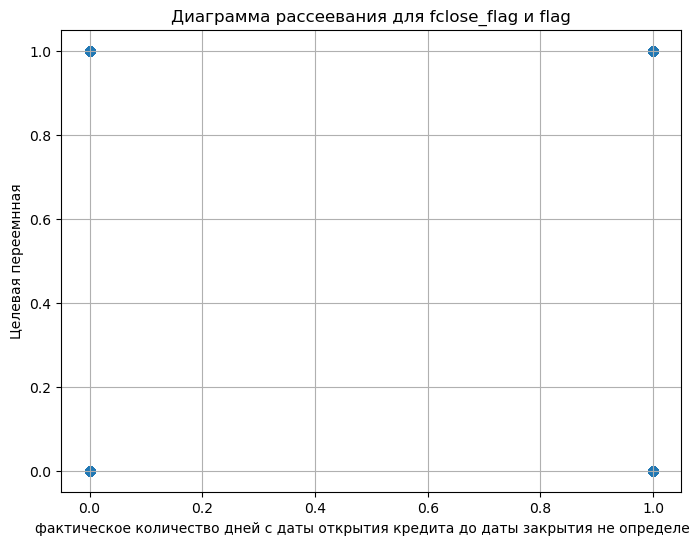

In [65]:
plt.figure(figsize=(8, 6))
plt.scatter(merged_df['fclose_flag'], merged_df['flag'])
plt.xlabel('фактическое количество дней с даты открытия кредита до даты закрытия не определено')
plt.ylabel('Целевая переемнная')
plt.title('Диаграмма рассеевания для fclose_flag и flag')
plt.grid(True)
plt.show()

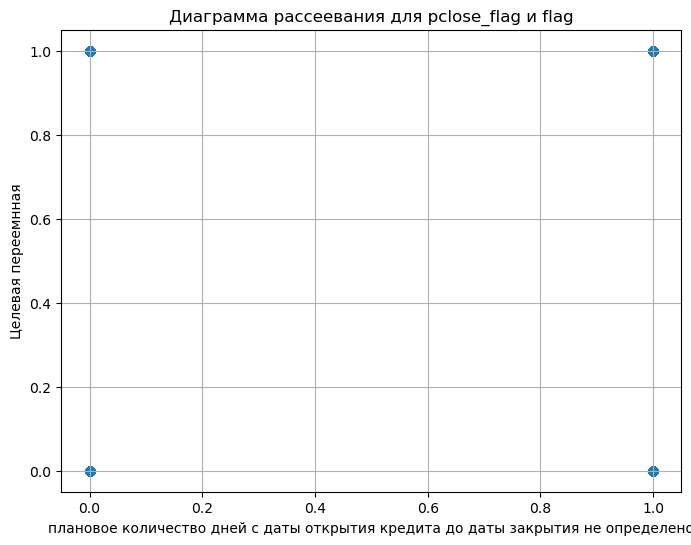

In [66]:
plt.figure(figsize=(8, 6))
plt.scatter(merged_df['pclose_flag'], merged_df['flag'])
plt.xlabel('плановое количество дней с даты открытия кредита до даты закрытия не определено')
plt.ylabel('Целевая переемнная')
plt.title('Диаграмма рассеевания для pclose_flag и flag')
plt.grid(True)
plt.show()

In [ ]:
# Оставим пока как есть. Обучим модель

# 6. Обробатываем датафрейм. Удаляем малозначимые колонки и добавляем новые фичи

Посмотрим на фичи. Если есть колонки которые имеют 2 или меньше значении посмотрим на них и решим что делать дальше

In [52]:
# Проходим по каждому столбцу
for column in merged_df.columns:
    # Считаем количество уникальных значений в столбце
    unique_values_count = merged_df[column].nunique()
    
    # Если количество уникальных значений равно или меньше 2, выводим название столбца и значение каунта
    if unique_values_count <= 2:
        print(f"Столбец: {column}, Значение каунта: {unique_values_count}")

Столбец: pre_loans_total_overdue, Значение каунта: 1
Столбец: is_zero_loans5, Значение каунта: 2
Столбец: is_zero_loans530, Значение каунта: 2
Столбец: is_zero_loans3060, Значение каунта: 2
Столбец: is_zero_loans6090, Значение каунта: 2
Столбец: is_zero_loans90, Значение каунта: 2
Столбец: is_zero_util, Значение каунта: 2
Столбец: is_zero_over2limit, Значение каунта: 2
Столбец: is_zero_maxover2limit, Значение каунта: 2
Столбец: pclose_flag, Значение каунта: 2
Столбец: fclose_flag, Значение каунта: 2
Столбец: flag, Значение каунта: 2


In [54]:
merged_df['pre_loans_total_overdue'].value_counts()

#Эту фичу можно удалять потому что оно не несет никакой информативности

pre_loans_total_overdue
0    4082029
Name: count, dtype: int64

In [55]:
merged_df['is_zero_loans5'].value_counts()


is_zero_loans5
1    3688877
0     393152
Name: count, dtype: int64

In [56]:
merged_df['is_zero_loans530'].value_counts()


is_zero_loans530
1    3418169
0     663860
Name: count, dtype: int64

In [57]:
merged_df['is_zero_loans3060'].value_counts()


is_zero_loans3060
1    3917020
0     165009
Name: count, dtype: int64

In [58]:
merged_df['is_zero_loans6090'].value_counts()


is_zero_loans6090
1    3996031
0      85998
Name: count, dtype: int64

In [59]:
merged_df['is_zero_loans90'].value_counts()


is_zero_loans90
1    3998724
0      83305
Name: count, dtype: int64

In [60]:
merged_df['is_zero_util'].value_counts()


is_zero_util
1    2888587
0    1193442
Name: count, dtype: int64

In [61]:
merged_df['is_zero_over2limit'].value_counts()


is_zero_over2limit
1    3845930
0     236099
Name: count, dtype: int64

In [62]:
merged_df['is_zero_maxover2limit'].value_counts()


is_zero_maxover2limit
1    3439644
0     642385
Name: count, dtype: int64

In [63]:
merged_df['pclose_flag'].value_counts()


pclose_flag
0    3401576
1     680453
Name: count, dtype: int64

In [64]:
merged_df['fclose_flag'].value_counts()


fclose_flag
0    3142206
1     939823
Name: count, dtype: int64

Остальные фичи оставляем пока

Начнем готовить данные к модели машинного обучения

In [67]:
merged_df.to_csv('merged_df', index=False)

In [85]:
# Создадим копию датафрейма
df1 = merged_df.copy()

# Создание новых фичей
# 1. Продолжительность кредита
df1['credit_duration'] = df1['pre_fterm'] - df1['pre_since_opened']

# 2. Плановая продолжительность кредита
df1['planned_credit_duration'] = df1['pre_pterm'] - df1['pre_since_opened']

# Удаление ненужных фичей
# Список фичей, которые нужно удалить
columns_to_drop = ['id', 'rn', 'pre_loans_total_overdue']

# Удаление указанных фичей из датафрейма
df1.drop(columns=columns_to_drop, inplace=True)

In [107]:
# Для подбора гиперпараметров возьмем малую часть данных

# Разделяем данные на подвыборки для flag = 1 и flag = 0
flag_1_data = df1[df1['flag'] == 1]
flag_0_data = df1[df1['flag'] == 0]

# Получаем 10% данных для flag = 1 и 1,5% данных для flag = 0
flag_1_sample = flag_1_data.sample(frac=0.1, random_state=42)
flag_0_sample = flag_0_data.sample(frac=0.015, random_state=42)

# Объединяем образцы в один датафрейм
flag_df = pd.concat([flag_1_sample, flag_0_sample])

# Перемешиваем строки в полученном датафрейме
flag_df = flag_df.sample(frac=1, random_state=42)

# Проверяем размер полученного датафрейма
print(flag_df.shape)

(71424, 62)


In [108]:
flag_df['flag'].value_counts()

flag
0    59431
1    11993
Name: count, dtype: int64

In [111]:
# Преобразование всех столбцов из типа int64 в тип int32
flag_df = flag_df.astype('int32')

# 7. Создаем и обучаем модели машинного обучения(Поиск по сетке на урезанных данных)

In [112]:
# Разелим наш датасет на Х и у

X = flag_df.drop('flag', axis=1)
y = flag_df['flag']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [113]:
# Начнем обучение модели с RandomForestClassifier

# Определение модели
rf_model = RandomForestClassifier(class_weight='balanced', random_state=42)

# Определение сетки параметров для поиска
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Создание объекта для поиска по сетке
rf_grid_search = GridSearchCV(rf_model, param_grid, cv=5, scoring='roc_auc', error_score='raise')

# Обучение модели
rf_grid_search.fit(X_train, y_train)

# Оценка лучших параметров
print("Лучшие параметры:", rf_grid_search.best_params_)

# Предсказание на тестовой выборке
rf_preds = rf_grid_search.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
rf_auc = roc_auc_score(y_test, rf_preds)
print("ROC AUC для Random Forest:", rf_auc)


Лучшие параметры: {'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 300}
ROC AUC для Random Forest: 0.6423641417029946


In [114]:
# Модель CatBoostClassifier

# Определение модели
catboost_model = CatBoostClassifier(class_weights=[1, 10], random_state=42, silent=True, task_type='GPU')

# Определение сетки параметров для поиска
param_grid = {
    'iterations': [100, 200, 300],
    'depth': [4, 6, 8],
    'learning_rate': [0.01, 0.1, 0.3]
}

# Создание объекта для поиска по сетке
catboost_grid_search = GridSearchCV(catboost_model, param_grid, cv=5, scoring='roc_auc', error_score='raise')

# Обучение модели
catboost_grid_search.fit(X_train, y_train)

# Оценка лучших параметров
print("Лучшие параметры:", catboost_grid_search.best_params_)

# Предсказание на тестовой выборке
catboost_preds = catboost_grid_search.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
catboost_auc = roc_auc_score(y_test, catboost_preds)
print("ROC AUC для CatBoost:", catboost_auc)


Лучшие параметры: {'depth': 4, 'iterations': 200, 'learning_rate': 0.1}
ROC AUC для CatBoost: 0.6587691906720179


In [115]:
# Модель LGBMClassifier

# Определение модели
lgbm_model = LGBMClassifier(class_weight='balanced', random_state=42, device='gpu')

# Определение сетки параметров для поиска
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [5, 10, 15],
    'learning_rate': [0.01, 0.1, 0.3]
}

# Создание объекта для поиска по сетке
lgbm_grid_search = GridSearchCV(lgbm_model, param_grid, cv=5, scoring='roc_auc', n_jobs=-1, error_score='raise')

# Обучение модели
lgbm_grid_search.fit(X_train, y_train)

# Оценка лучших параметров
print("Лучшие параметры:", lgbm_grid_search.best_params_)

# Предсказание на тестовой выборке
lgbm_preds = lgbm_grid_search.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
lgbm_auc = roc_auc_score(y_test, lgbm_preds)
print("ROC AUC для LightGBM:", lgbm_auc)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Number of positive: 8430, number of negative: 41566
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 436
[LightGBM] [Info] Number of data points in the train set: 49996, number of used features: 57
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4050 Laptop GPU, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 64 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 23 dense feature groups (1.14 MB) transferred to GPU in 0.003725 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
Лу

In [124]:
# Так же попробует нейронную сеть

# Определение нейронной сети в PyTorch
class NeuralNetwork(nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(NeuralNetwork, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(hidden_size, output_size)
        self.sigmoid = nn.Sigmoid()
    
    def forward(self, x):
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.sigmoid(x)
        return x

# Определение функции для оптимизации (по ROC AUC)
def optimize_nn(search_params, X_train_fold, y_train_fold, X_test_fold, y_test_fold):
    input_size = X_train_fold.shape[1]
    hidden_size = search_params['hidden_size']
    lr = search_params['lr']
    batch_size = search_params['batch_size']
    
    # Создание экземпляра модели
    net = NeuralNetClassifier(
        module=NeuralNetwork,
        module__input_size=input_size,
        module__hidden_size=hidden_size,
        module__output_size=1,
        criterion=nn.BCELoss,
        optimizer=optim.Adam,
        optimizer__lr=lr,
        max_epochs=50,
        batch_size=batch_size,
        iterator_train__shuffle=True,
        device='cuda' if torch.cuda.is_available() else 'cpu',
    )

    # Обучение модели на обучающем наборе текущего сплита
    net.fit(X_train_fold, y_train_fold)

    # Получение оценки ROC AUC на тестовом наборе текущего сплита
    y_proba = net.predict_proba(X_test_fold)
    return roc_auc_score(y_test_fold, y_proba[:, 1])

# Определение пространства поиска гиперпараметров
search_space = {
    'n_estimators': (50, 200),  # Количество деревьев
    'max_depth': (5, 20),         # Максимальная глубина деревьев
    'min_samples_split': (2, 20),  # Минимальное число образцов, необходимое для разделения внутреннего узла
    'min_samples_leaf': (1, 10)    # Минимальное число образцов, необходимое для листового узла
}

# Создание экземпляра объекта StratifiedKFold
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Переменные для хранения лучших гиперпараметров и оценки ROC AUC
best_params = None
best_score = 0.0

# Цикл кросс-валидации
for train_index, test_index in skf.split(X_train, y_train):
    # Преобразование индексов в массивы (списки)
    train_idx_list = train_index.tolist()
    test_idx_list = test_index.tolist()
    
    # Выделение данных для обучения и теста
    X_train_fold, X_test_fold = X_train.iloc[train_idx_list], X_train.iloc[test_idx_list]
    y_train_fold, y_test_fold = y_train.iloc[train_idx_list], y_train.iloc[test_idx_list]

    # Создание экземпляра объекта BayesSearchCV для текущего сплита
    search = BayesSearchCV(
        estimator=RandomForestClassifier(),  # Оцениваемая модель
        search_spaces=search_space,
        scoring='roc_auc',
        n_jobs=-1,
        cv=5,
    )

    # Поиск оптимальных гиперпараметров на текущем сплите
    search.fit(X_train_fold, y_train_fold)

    # Получение лучших гиперпараметров и оценки ROC AUC на текущем сплите
    fold_best_params = search.best_params_
    fold_best_score = search.best_score_

    # Сравнение с предыдущими результатами
    if fold_best_score > best_score:
        best_params = fold_best_params
        best_score = fold_best_score

# Вывод лучших гиперпараметров и оценки ROC AUC
print("Лучшие гиперпараметры:", best_params)
print("Лучшая оценка ROC AUC:", best_score)


Лучшие гиперпараметры: OrderedDict([('max_depth', 14), ('min_samples_leaf', 7), ('min_samples_split', 20), ('n_estimators', 200)])
Лучшая оценка ROC AUC: 0.6426162118857299


И так наивыйсший скор у нас показала модель CatBoostClassifier с 0,658 на малой выборке. Обучим его на большой выборке используя кросс_валл_скор и посмотрим на результаты. А так же проверим нейронную сеть, ведь чем больше данных тем лучше нейронка обучается

In [128]:
# Применяем SMOTE для балансировки обучающей выборки

smote = SMOTE(random_state=1)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

In [137]:
# Определение модели CatBoostClassifier
catboost_model = CatBoostClassifier(learning_rate=0.1, random_state=42, silent=True, task_type='GPU')

# Выполнение кросс-валидации с оценкой ROC AUC
roc_auc_scores = cross_val_score(catboost_model, X_train_resampled, y_train_resampled, cv=5, scoring='roc_auc')

# Вывод оценок ROC AUC для каждого сплита
print("ROC AUC для каждого сплита:", roc_auc_scores)

# Средняя оценка ROC AUC
mean_roc_auc = roc_auc_scores.mean()
print("Средняя оценка ROC AUC:", mean_roc_auc)

ROC AUC для каждого сплита: [0.88642269 0.94111497 0.94153674 0.94192601 0.94117014]
Средняя оценка ROC AUC: 0.9304341077737617


In [146]:
catboost_model.fit(X_train_resampled, y_train_resampled)

In [147]:
y_pred = catboost_model.predict(X_test)

In [148]:
# Предсказание вероятностей на тестовом наборе данных
catboost_preds = catboost_model.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
roc_auc_test = roc_auc_score(y_test, catboost_preds)

# Вывод ROC AUC
print("ROC AUC на тестовых данных для CatBoost:", roc_auc_test)

ROC AUC на тестовых данных для CatBoost: 0.5882946611654232


In [149]:
confusion_matrix(y_test, y_pred)

array([[1017220,  171396],
       [  26349,    9644]], dtype=int64)

Видим что чтото пошло не по плану. Откатываемся назад и пробуем поискать другие варианты

## Модели получаются слабые, стараемся отойти назад до самого начала и найти другой способ обработки данных

***Создаем класс для агрегации данных и кодирования категориальных признаков. Выдаем на вход сырые данные для обработки***

In [16]:
class CountAggregator(object):
    """
    Класс для агрегации данных и кодирования категориальных признаков.
    """
    
    def __init__(self):
        """
        Инициализация объекта CountAggregator.
        """
        self.encoded_features = None  # Инициализация списка закодированных признаков
        
    def __extract_count_aggregations(self, data_frame: pd.DataFrame) -> pd.DataFrame:
        """
        Производит агрегацию и кодирование категориальных признаков входного датафрейма.

        Аргументы:
        - data_frame: pd.DataFrame - Входной датафрейм.

        Возвращает:
        - pd.DataFrame: Результат агрегации и кодирования.
        """
        # Отбрасываем идентификационные и лишние колонки
        feature_columns = list(data_frame.columns.values)
        feature_columns.remove("id")
        feature_columns.remove("rn")

        # Применяем One-Hot Encoding
        dummies = pd.get_dummies(data_frame[feature_columns], columns=feature_columns)
        dummy_features = dummies.columns.values
        
        # Объединяем закодированные признаки с исходным датафреймом
        ohe_features = pd.concat([data_frame, dummies], axis=1)
        ohe_features = ohe_features.drop(columns=feature_columns)
        
        # Агрегируем данные по идентификатору
        features = ohe_features.groupby("id")[dummy_features].sum().reset_index(drop=False)
        return features
        
    def fit_transform(self, data_frame: pd.DataFrame) -> pd.DataFrame:
        """
        Производит агрегацию и кодирование категориальных признаков входного датафрейма.

        Аргументы:
        - data_frame: pd.DataFrame - Входной датафрейм.

        Возвращает:
        - pd.DataFrame: Результат агрегации и кодирования.
        """
        features = self.__extract_count_aggregations(data_frame)
        features.fillna(np.uint8(0), inplace=True)
        dummy_features = list(features.columns.values)
        dummy_features.remove("id")
        self.encoded_features = dummy_features
        return features
    
    def transform(self, data_frame: pd.DataFrame) -> pd.DataFrame:
        """
        Производит агрегацию и кодирование категориальных признаков входного датафрейма.

        Аргументы:
        - data_frame: pd.DataFrame - Входной датафрейм.

        Возвращает:
        - pd.DataFrame: Результат агрегации и кодирования.
        """
        features = self.__extract_count_aggregations(data_frame)
        features.fillna(np.uint8(0), inplace=True)
        dummy_features = list(features.columns.values)
        dummy_features.remove("id")
        for col in self.encoded_features:
            if col not in dummy_features:
                features[col] = np.uint8(0)
        return features

In [17]:
# Создание экземпляра класса CountAggregator
count_aggregator = CountAggregator()

# Применение метода fit_transform для выполнения кодирования и агрегации
processed_data = count_aggregator.fit_transform(data)

In [18]:
# проверяем как все прошло

processed_data.head()

,id,pre_since_opened_0,pre_since_opened_1,pre_since_opened_2,pre_since_opened_3,pre_since_opened_4,pre_since_opened_5,pre_since_opened_6,pre_since_opened_7,pre_since_opened_8,...,enc_loans_credit_type_4,enc_loans_credit_type_5,enc_loans_account_cur_0,enc_loans_account_cur_1,enc_loans_account_cur_2,enc_loans_account_cur_3,pclose_flag_0,pclose_flag_1,fclose_flag_0,fclose_flag_1
0,0,0,1,1,1,1,2,0,1,0,...,7,0,0,10,0,0,9,1,8,2
1,1,0,0,1,0,0,0,0,1,2,...,8,0,0,14,0,0,13,1,12,2
2,2,1,0,0,0,0,0,0,0,0,...,1,0,0,3,0,0,1,2,1,2
3,3,0,3,1,0,2,1,3,0,0,...,9,1,0,15,0,0,10,5,9,6
4,4,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,1,0,1


In [19]:
# выводим размерности

processed_data.shape

(500000, 401)

In [20]:
# проверяем на пустоты

processed_data.isna().sum().sum()

0

In [21]:
# объеденяем с таргет датафреймом по колонке id

processed_data = pd.merge(processed_data, targets, on='id', how='inner')

In [22]:
# проверяем распределение значении целевой переменной

processed_data['flag'].value_counts()

flag
0    484054
1     15946
Name: count, dtype: int64

***Разделим датафрейм на X_train, X_test***

In [23]:
processed_data = processed_data.astype('int8')

X = processed_data.drop(['flag', 'id'], axis=1)
y = processed_data['flag']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [330]:
# # Применяем SMOTE для балансировки обучающей выборки

# smote = SMOTE(random_state=1)
# X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# пробывал использывать, лучше не стоит

# 8. Ищем оптимальные гиперпараметры

***Создаем модели машинного обучения и делаем поиск по сетке для поиска оптимальных гиперпараметров***

Выбираем только те модели которые в прошлый раз показали хороший результат

In [262]:
# Модель CatBoostClassifier

# Определение модели
catboost_model = CatBoostClassifier(class_weights=[1, 10], random_state=42, silent=True, task_type='GPU')

# Определение сетки параметров для поиска
param_grid = {
    'iterations': [500, 1000, 2000],
    'depth': [4, 6, 8],
    'learning_rate': [0.01, 0.05, 0.1]
}

# Создание объекта для поиска по сетке
catboost_grid_search = GridSearchCV(catboost_model, param_grid, cv=5, scoring='roc_auc', error_score='raise')

# Обучение модели
catboost_grid_search.fit(X_train, y_train)

# Оценка лучших параметров
print("Лучшие параметры:", catboost_grid_search.best_params_)

# Предсказание на тестовой выборке
catboost_preds = catboost_grid_search.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
catboost_auc = roc_auc_score(y_test, catboost_preds)
print("ROC AUC для CatBoost:", catboost_auc)


Лучшие параметры: {'depth': 6, 'iterations': 2000, 'learning_rate': 0.01}
ROC AUC для CatBoost: 0.6748247602641204


In [320]:
# Определение модели CatBoostClassifier
catboost = CatBoostClassifier(iterations=2000, class_weights=[1, 10],
                              depth=5,learning_rate=0.1, random_state=42, 
                              silent=True, task_type='GPU')

# Выполнение кросс-валидации с оценкой ROC AUC
roc_auc_scores = cross_val_score(catboost, X_train, y_train, cv=5, scoring='roc_auc', error_score='raise')

# Вывод оценок ROC AUC для каждого сплита
print("ROC AUC для каждого сплита:", roc_auc_scores)

# Средняя оценка ROC AUC
mean_roc_auc = roc_auc_scores.mean()
print("Средняя оценка ROC AUC:", mean_roc_auc)

ROC AUC для каждого сплита: [0.7545074  0.74576291 0.75437251 0.75298786 0.75171648]
Средняя оценка ROC AUC: 0.7518694312271023


In [321]:
catboost.fit(X_train, y_train)

In [322]:
y_pred = catboost.predict(X_test)

In [323]:
# Предсказание вероятностей на тестовом наборе данных
catboost_preds = catboost.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
roc_auc_test = roc_auc_score(y_test, catboost_preds)

# Вывод ROC AUC
print("ROC AUC на тестовых данных для CatBoost:", roc_auc_test)

ROC AUC на тестовых данных для CatBoost: 0.7578662559635632


In [324]:
confusion_matrix(y_test, y_pred)

array([[139347,   5837],
       [  3836,    980]], dtype=int64)

In [354]:
# Модель LGBMClassifier

# Определение модели
lgbm_model = LGBMClassifier(class_weight='balanced', random_state=42, device='gpu')

# Определение сетки параметров для поиска
param_grid = {
    'n_estimators': [500, 1000, 2000],
    'max_depth': [5, 10, 15],
    'learning_rate': [0.01, 0.05, 0.1],
    'num_leaves': [32, 64, 128], 
    'reg_lambda': [0.1, 0.05, 1]
}

# Создание объекта для поиска по сетке
lgbm_grid_search = GridSearchCV(lgbm_model, param_grid, cv=5, scoring='roc_auc', n_jobs=-1, error_score='raise')

# Обучение модели
lgbm_grid_search.fit(X_train, y_train)

# Оценка лучших параметров
print("Лучшие параметры:", lgbm_grid_search.best_params_)

# Предсказание на тестовой выборке
lgbm_preds = lgbm_grid_search.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
lgbm_auc = roc_auc_score(y_test, lgbm_preds)
print("ROC AUC для LightGBM:", lgbm_auc)

[LightGBM] [Info] Number of positive: 11130, number of negative: 338870
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5781
[LightGBM] [Info] Number of data points in the train set: 350000, number of used features: 384
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4050 Laptop GPU, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 64 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 91 dense feature groups (30.71 MB) transferred to GPU in 0.025476 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
Лучшие параметры: {'learning_rate': 0.01, 'max_depth': 15, 'n_estimators': 1000, 'num_leaves': 32, 'reg_lambda': 1}
ROC AUC для LightGBM: 0.7725076411799952


In [360]:
# Модель LGBMClassifier

# Определение модели
lgbm = LGBMClassifier(n_estimators=1000, max_depth=15, learning_rate=0.01, 
                            num_leaves=32, reg_lambda=1,
                            random_state=42, device='gpu')

# Выполнение кросс-валидации с оценкой ROC AUC
roc_auc_scores = cross_val_score(lgbm, X_train, y_train, cv=5, scoring='roc_auc')

# Вывод оценок ROC AUC для каждого сплита
print("ROC AUC для каждого сплита:", roc_auc_scores)

# Средняя оценка ROC AUC
mean_roc_auc = roc_auc_scores.mean()
print("Средняя оценка ROC AUC:", mean_roc_auc)

[LightGBM] [Info] Number of positive: 8904, number of negative: 271096
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5747
[LightGBM] [Info] Number of data points in the train set: 280000, number of used features: 383
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4050 Laptop GPU, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 64 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 91 dense feature groups (24.57 MB) transferred to GPU in 0.020808 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.031800 -> initscore=-3.415972
[LightGBM] [Info] Start training from score -3.415972
[LightGBM] [Info] Number of positive: 8904, number of negative: 271096
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5755
[LightGBM] [Info] Number of data points in the train set: 280000, number of used features: 382
[LightGBM] 

In [361]:
lgbm.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 11130, number of negative: 338870
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5781
[LightGBM] [Info] Number of data points in the train set: 350000, number of used features: 384
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4050 Laptop GPU, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 64 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 91 dense feature groups (30.71 MB) transferred to GPU in 0.024349 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.031800 -> initscore=-3.415972
[LightGBM] [Info] Start training from score -3.415972


LGBMClassifier(device='gpu', learning_rate=0.01, max_depth=15,
               n_estimators=1000, num_leaves=32, random_state=42, reg_lambda=1)

In [362]:
y_pred = lgbm.predict(X_test)

In [363]:
# Предсказание вероятностей на тестовом наборе данных
lgbm_preds = lgbm.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
roc_auc_test = roc_auc_score(y_test, lgbm_preds)

# Вывод ROC AUC
print("ROC AUC на тестовых данных для lgbm:", roc_auc_test)

ROC AUC на тестовых данных для CatBoost: 0.7731140002682815


In [364]:
confusion_matrix(y_test, y_pred)

array([[145182,      2],
       [  4816,      0]], dtype=int64)

Очень очень плохо. То как модель предсказывает все в один класс это очень плохие показатели

***Ищем теперь не только ROC_AUC но и recall, что бы узнать достойна ли модель продакшена***

*во загнул XD*

In [24]:
from sklearn.metrics import recall_score
from sklearn.model_selection import cross_val_predict

# Модель LGBMClassifier
lgbm_model = LGBMClassifier(n_estimators=1000, max_depth=20, learning_rate=0.01, 
                            num_leaves=34, reg_lambda=1, class_weight='balanced',
                            random_state=42, device='gpu')

# Выполнение кросс-валидации с оценкой Recall
recall_scores = cross_val_score(lgbm_model, X_train, y_train, cv=5, scoring='recall')

# Вывод оценок Recall для каждого сплита
print("Recall для каждого сплита:", recall_scores)

# Средняя оценка Recall
mean_recall = recall_scores.mean()
print("Средняя оценка Recall:", mean_recall)


[LightGBM] [Info] Number of positive: 8904, number of negative: 271096
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5747
[LightGBM] [Info] Number of data points in the train set: 280000, number of used features: 383
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4050 Laptop GPU, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 64 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 91 dense feature groups (24.57 MB) transferred to GPU in 0.017534 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
[LightGBM] [Info] Number of positive: 8904, number of negative: 271096
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5755
[LightGBM] [Info] Number of data points in the train set: 280000, number of used features: 382
[LightGBM] [I

In [25]:
lgbm_model.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 11130, number of negative: 338870
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5781
[LightGBM] [Info] Number of data points in the train set: 350000, number of used features: 384
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4050 Laptop GPU, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 64 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 91 dense feature groups (30.71 MB) transferred to GPU in 0.021483 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


LGBMClassifier(class_weight='balanced', device='gpu', learning_rate=0.01,
               max_depth=20, n_estimators=1000, num_leaves=34, random_state=42,
               reg_lambda=1)

In [26]:
y_pred = lgbm_model.predict(X_test)

In [27]:
# Предсказание вероятностей на тестовом наборе данных
lgbm_preds = lgbm_model.predict_proba(X_test)[:, 1]

# Вычисление ROC AUC
recall_test = recall_score(y_test, y_pred)

# Вычисление ROC AUC
roc_auc_test = roc_auc_score(y_test, lgbm_preds)

# Вывод ROC AUC
print("ROC AUC на тестовых данных для lgbm:", roc_auc_test)

# Вывод ROC AUC
print("Recall на тестовых данных для lgbm:", recall_test)

ROC AUC на тестовых данных для lgbm: 0.7723978259264267
Recall на тестовых данных для lgbm: 0.6856312292358804


In [46]:
confusion_matrix(y_test, y_pred)

array([[103791,  41393],
       [  1514,   3302]], dtype=int64)

Так мне нравится гораздо больше

In [29]:
from sklearn.metrics import ConfusionMatrixDisplay

Confusion Matrix:
[[103791  41393]
 [  1514   3302]]


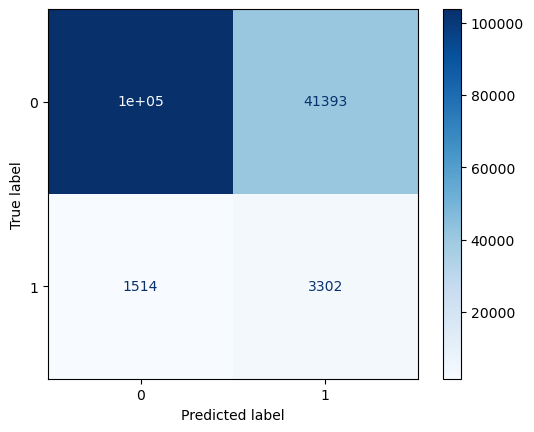

In [44]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Расчет матрицы
cm = confusion_matrix(y_test, y_pred)

# Визуализация
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)

# Интерпретация
print("Confusion Matrix:")
print(cm)

plt.show()


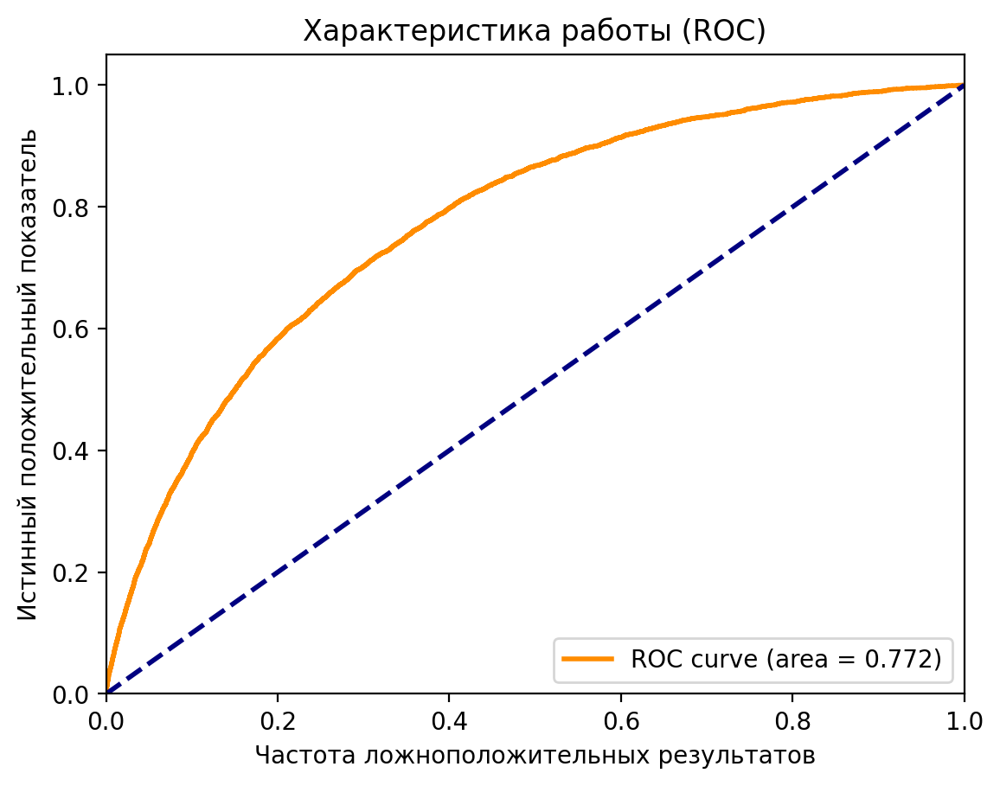

In [42]:
from sklearn.metrics import roc_curve, auc

# Рассчитываем значения ROC и AUC
fpr, tpr, thresholds = roc_curve(y_test, lgbm_preds) 
roc_auc = auc(fpr, tpr)

# Строим ROC-кривую
plt.figure(dpi=200)
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Частота ложноположительных результатов')
plt.ylabel('Истинный положительный показатель')
plt.title('Характеристика работы (ROC)')
plt.legend(loc="lower right")
plt.show()

# 9. Находим наилучшую модель для данной задачи и сохраняем предикты

***После бесконечного перебора гиперпараметров находим модель и сохраняем предикты***

In [419]:
# Сохраним предикты в csv файл

# Создание DataFrame с предсказаниями
predictions_df = pd.DataFrame({
    'True_Values': y_test,
    'Predictions': y_pred 
})

# Сохранение DataFrame в CSV файл
predictions_df.to_csv('predictions.csv', index=False)

In [420]:
predictions_df

,True_Values,Predictions
104241,0,0
199676,0,0
140199,0,0
132814,0,1
408697,0,0
163280,0,1
215758,0,0
442316,0,0
6940,0,0
382310,0,0


# Далее ваш ждет серия еще экспериментов для поиска компрамиса между ROC_AUC и RECALL. Можно пропустить

In [42]:
from sklearn.metrics import precision_recall_curve, auc

# Создание модели LGBMClassifier с заданными параметрами
lgbm_model = LGBMClassifier(n_estimators=1000, max_depth=20, learning_rate=0.01, 
                            num_leaves=34, reg_lambda=1, class_weight='balanced',
                            random_state=42, device='gpu')

# Выполнение кросс-валидации с предсказанием вероятностей
y_proba = cross_val_predict(lgbm_model, X_train, y_train, cv=5, method='predict_proba')

# Применение порога 0.4 к вероятностям
y_pred = (y_proba[:, 1] > 0.6).astype(int)

# Получение значений precision и recall для бинарных меток
precision, recall, _ = precision_recall_curve(y_train, y_pred)

# Вычисление PR AUC
pr_auc = auc(recall, precision)
print("Precision-Recall AUC с порогом 0.6:", pr_auc)


[LightGBM] [Info] Number of positive: 8904, number of negative: 271096
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5747
[LightGBM] [Info] Number of data points in the train set: 280000, number of used features: 383
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4050 Laptop GPU, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 64 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 91 dense feature groups (24.57 MB) transferred to GPU in 0.014656 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
[LightGBM] [Info] Number of positive: 8904, number of negative: 271096
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5755
[LightGBM] [Info] Number of data points in the train set: 280000, number of used features: 382
[LightGBM] [I

In [43]:
# Построение матрицы ошибок
confusion_matrix(y_train, y_pred)

array([[281092,  57778],
       [  5272,   5858]], dtype=int64)

In [47]:
lgbm_model = LGBMClassifier(n_estimators=1000, max_depth=20, learning_rate=0.01, 
                            num_leaves=34, reg_lambda=1, class_weight='balanced',
                            random_state=42, device='gpu')

lgbm_model.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 11130, number of negative: 338870
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 5781
[LightGBM] [Info] Number of data points in the train set: 350000, number of used features: 384
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce RTX 4050 Laptop GPU, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 64 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 91 dense feature groups (30.71 MB) transferred to GPU in 0.019498 secs. 1 sparse feature groups
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


LGBMClassifier(class_weight='balanced', device='gpu', learning_rate=0.01,
               max_depth=20, n_estimators=1000, num_leaves=34, random_state=42,
               reg_lambda=1)

In [168]:
# Получение вероятностей принадлежности к классу 1 для тестовых данных
y_proba_test = lgbm_model.predict_proba(X_test)[:, 1]

# Применение порога 0.7 к вероятностям
threshold = 0.47
y_pred_test = (y_proba_test > threshold).astype(int)

# Оценка Precision и Recall
precision, recall, _ = precision_recall_curve(y_test, y_pred_test)
pr_auc = auc(recall, precision)

In [169]:
pr_auc

0.4016445222257983

In [170]:
roc_auc_score(y_test, y_pred_test)

0.7012289869123346

In [171]:
confusion_matrix(y_test, y_pred_test)

array([[98344, 46840],
       [ 1324,  3492]], dtype=int64)